In [6]:
from google.colab import files
uploaded = files.upload()

Saving full_CNN_labels.zip to full_CNN_labels.zip


In [8]:
!unzip full_CNN_labels.zip
!ls -l


Archive:  full_CNN_labels.zip
  inflating: full_CNN_labels.p       
  inflating: full_CNN_train.p        
total 1000016
-rw-r--r-- 1 root root 164188504 Jan  7 16:10 full_CNN_labels.p
-rw-r--r-- 1 root root 368885836 Jan 12 19:29 full_CNN_labels.zip
-rw-r--r-- 1 root root 490915614 Jan  7 16:20 full_CNN_train.p
-rw-r--r-- 1 root root         0 Jan 12 18:37 sad.txt
drwxr-xr-x 1 root root      4096 Jan  7 14:33 sample_data


In [3]:
!ls


 full_CNN_labels.p     full_CNN_train.p    proj_reg_vid.mp4  'Test Video 1.mp4'
 full_CNN_labels.zip   proj_reg_vid1.mp4   sad.txt	     'Test Video 2.mp4'
 full_CNN_model.h5     proj_reg_vid2.mp4   sample_data


## Import Necessary libraries 

In [4]:
import numpy as np
import pickle
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
import keras
import matplotlib.pyplot as plt
# Import necessary items from Keras
from keras.models import Sequential
from keras.layers import Activation, Dropout, UpSampling2D
from keras.layers import Conv2DTranspose, Conv2D, MaxPooling2D
from keras.layers.normalization.batch_normalization import BatchNormalization
from keras.preprocessing.image import ImageDataGenerator
from keras import regularizers

## Model Architecture


  



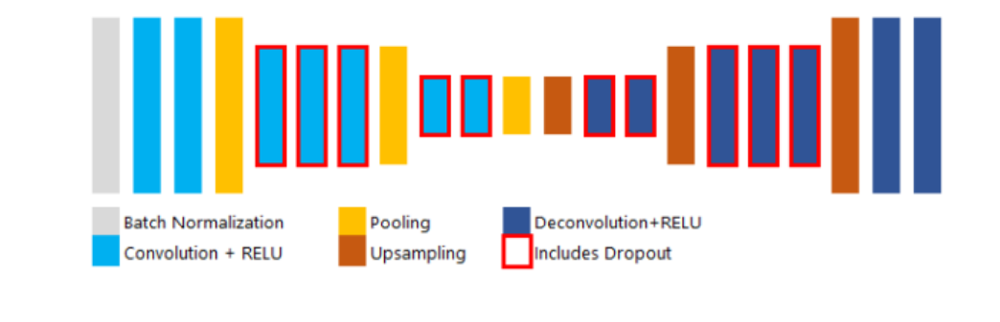

## Model creation

In [6]:
def create_model(input_shape ):
    # TODO: Create the Model
    pool_size = (2,2)
    model = Sequential([
    BatchNormalization(input_shape=input_shape),
    Conv2D(8, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv1'),
    Conv2D(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv2'),
    MaxPooling2D(pool_size=pool_size),
    Conv2D(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv3'),
    Dropout(0.2),
    Conv2D(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv4'),
    Dropout(0.2),
    Conv2D(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv5'),
    Dropout(0.2),
    MaxPooling2D(pool_size=pool_size),
    Conv2D(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv6'),
    Dropout(0.2),
    Conv2D(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Conv7'),
    Dropout(0.2),
    MaxPooling2D(pool_size=pool_size),
    UpSampling2D(size=pool_size),
    Conv2DTranspose(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv1'),
    Dropout(0.2),
    Conv2DTranspose(64, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv2'),
    Dropout(0.2),
    UpSampling2D(size=pool_size),
    Conv2DTranspose(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv3'),
    Dropout(0.2),
    Conv2DTranspose(32, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv4'),
    Dropout(0.2),
    Conv2DTranspose(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv5'),
    Dropout(0.2),
    UpSampling2D(size=pool_size),
    Conv2DTranspose(16, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Deconv6'),
    Conv2DTranspose(1, (3, 3), padding='valid', strides=(1,1), activation = 'relu', name = 'Final')
    ])
    return model

## Loading Lane Dataset

In [7]:
# Load training images
train_images = pickle.load(open("full_CNN_train.p", "rb" ))

# Load image labels
labels = pickle.load(open("full_CNN_labels.p", "rb" ))

# Make into arrays as the neural network wants these
train_images = np.array(train_images)
labels = np.array(labels)


## preprocessing

In [8]:
labels = labels / 255.0

print (labels.shape)
print(train_images.shape)

(12764, 80, 160, 1)
(12764, 80, 160, 3)


## create train test split

In [9]:
# Shuffle images along with their labels, then split into training/validation sets
train_images, labels = shuffle(train_images, labels)
# Test size may be 10% or 20%
X_train, X_val, y_train, y_val = train_test_split(train_images, labels, test_size=0.1)

print(X_train.shape)
print(X_val.shape)


(11487, 80, 160, 3)
(1277, 80, 160, 3)


## ploting some train data

In [10]:
# This function will plot images in the form of a grid with 1 row and 5 columns where images are placed in each column.
def plotImages(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip(images_arr, axes):
        ax.imshow(img)
    plt.tight_layout()
    plt.show()

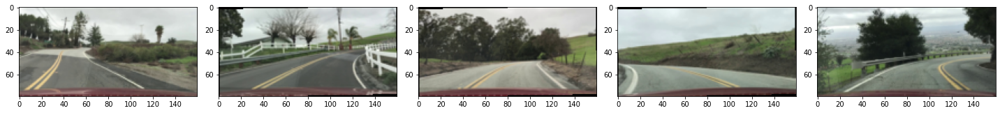

In [13]:

plotImages(X_train)


## Data Augmentation



Overfitting often occurs when we have a small number of training examples. One way to fix this problem is to augment our dataset so that it has sufficient number and variety of training examples. Data augmentation takes the approach of generating more training data from existing training samples, by augmenting the samples through ``` channel_shift_range``` that yield believable-looking images. The goal is that at training time, your model will never see the exact same picture twice. This exposes the model to more aspects of the data, allowing it to generalize better.

In [25]:

epochs = 20
batch_size = 200

image_gen_train = ImageDataGenerator( channel_shift_range=0.1)
train_data_gen = image_gen_train.flow(X_train, y_train, batch_size=batch_size)

image_gen_val = ImageDataGenerator()
val_data_gen = image_gen_val.flow(X_val,y_val,batch_size=batch_size)

## Model Training

In [26]:
input_shape = X_train.shape[1:] # shape of train data images

# Create the neural network
model = create_model(input_shape)



model.compile(optimizer='Adam', loss="mean_squared_error" , metrics=['accuracy'])



history = model.fit_generator(train_data_gen ,
                               steps_per_epoch= int(np.ceil(len(X_train)/float(batch_size))),
                               epochs=epochs,
                               verbose=1,
                               validation_data= val_data_gen,
                               validation_steps=int(np.ceil(len(X_val) / float(batch_size)))
                               )

model.trainable=False



Epoch 1/20
58/58 [==============================] - 30s 490ms/step - loss: 0.0858 - accuracy: 0.8687 - val_loss: 0.0584 - val_accuracy: 0.8921
Epoch 2/20
58/58 [==============================] - 28s 484ms/step - loss: 0.0256 - accuracy: 0.9422 - val_loss: 0.0199 - val_accuracy: 0.9480
Epoch 3/20
58/58 [==============================] - 28s 487ms/step - loss: 0.0167 - accuracy: 0.9513 - val_loss: 0.0146 - val_accuracy: 0.9514
Epoch 4/20
58/58 [==============================] - 28s 486ms/step - loss: 0.0137 - accuracy: 0.9535 - val_loss: 0.0119 - val_accuracy: 0.9544
Epoch 5/20
58/58 [==============================] - 28s 486ms/step - loss: 0.0120 - accuracy: 0.9549 - val_loss: 0.0114 - val_accuracy: 0.9547
Epoch 6/20
58/58 [==============================] - 28s 486ms/step - loss: 0.0109 - accuracy: 0.9557 - val_loss: 0.0092 - val_accuracy: 0.9566
Epoch 7/20
58/58 [==============================] - 28s 486ms/step - loss: 0.0100 - accuracy: 0.9564 - val_loss: 0.0086 - val_accuracy: 0.9567

## Saving the trained model

In [27]:
# Save model architecture and weights
model.trainable=False
model.save('full_CNN_model.h5')

# Show summary of model
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 batch_normalization_1 (Batc  (None, 80, 160, 3)       12        
 hNormalization)                                                 
                                                                 
 Conv1 (Conv2D)              (None, 78, 158, 8)        224       
                                                                 
 Conv2 (Conv2D)              (None, 76, 156, 16)       1168      
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 38, 78, 16)       0         
 2D)                                                             
                                                                 
 Conv3 (Conv2D)              (None, 36, 76, 16)        2320      
                                                                 
 dropout_10 (Dropout)        (None, 36, 76, 16)       

### Visualizing results of the training

visualize the results we get after training our network.

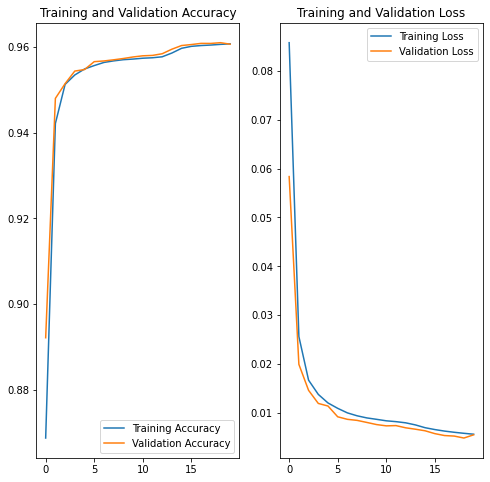

In [28]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

In [29]:
!ls

 full_CNN_labels.p     full_CNN_train.p    proj_reg_vid.mp4  'Test Video 1.mp4'
 full_CNN_labels.zip   proj_reg_vid1.mp4   sad.txt	     'Test Video 2.mp4'
 full_CNN_model.h5     proj_reg_vid2.mp4   sample_data


In [35]:
from google.colab import files
uploaded = files.upload()

Saving Test Video 2.mp4 to Test Video 2.mp4


## Trying some Tests

In [30]:
import numpy as np
import cv2
from sklearn.externals._pilutil import imresize
from moviepy.editor import VideoFileClip
from IPython.display import HTML
from keras.models import load_model


# Class to average lanes with
class Lanes():
    def __init__(self):
        self.recent_fit = []
        self.avg_fit = []


def road_lines(image):
    """ Takes in a road image, re-sizes for the model,
    predicts the lane to be drawn from the model in G color,
    recreates an RGB image of a lane and merges with the
    original road image.
    """

    # Get image ready for feeding into model
    small_img = imresize(image, (80, 160, 3))
    small_img = np.array(small_img)
    small_img = small_img[None,:,:,:]

    # Make prediction with neural network (un-normalize value by multiplying by 255)
    prediction = model.predict(small_img)[0] * 255

    # Add lane prediction to list for averaging
    lanes.recent_fit.append(prediction)
    # Only using last five for average
    if len(lanes.recent_fit) > 5:
        lanes.recent_fit = lanes.recent_fit[1:]

    # Calculate average detection
    lanes.avg_fit = np.mean(np.array([i for i in lanes.recent_fit]), axis = 0)

    # Generate fake R & B color dimensions, stack with G
    blanks = np.zeros_like(lanes.avg_fit).astype(np.uint8)
    lane_drawn = np.dstack((blanks, lanes.avg_fit, blanks))

    # Re-size to match the original image
    lane_image = imresize(lane_drawn, (720, 1280, 3))

    # Merge the lane drawing onto the original image
    result = cv2.addWeighted(image, 1, lane_image, 1, 0)

    return result


if __name__ == '__main__':
    # Load Keras model
    model = load_model('full_CNN_model.h5')
    # Create lanes object
    lanes = Lanes()

    # Where to save the output video
    vid_output = 'proj_reg_vid1.mp4'
    # Location of the input video
    clip1 = VideoFileClip("Test Video 1.mp4")
    # Create the clip
    vid_clip = clip1.fl_image(road_lines)
    vid_clip.write_videofile(vid_output, audio=False)


[MoviePy] >>>> Building video proj_reg_vid1.mp4
[MoviePy] Writing video proj_reg_vid1.mp4


100%|█████████▉| 1260/1261 [03:24<00:00,  6.16it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: proj_reg_vid1.mp4 



## Viewing test video after applying the trained model

In [31]:
from IPython.display import HTML
from base64 import b64encode
 
def show_video(video_path, video_width = 600):
   
  video_file = open(video_path, "r+b").read()
 
  video_url = f"data:video/mp4;base64,{b64encode(video_file).decode()}"
  return HTML(f"""<video width={video_width} controls><source src="{video_url}"></video>""")
 
show_video("proj_reg_vid1.mp4")

In [32]:
model = load_model('full_CNN_model.h5')
# Create lanes object
lanes = Lanes()

# Where to save the output video
vid_output = 'proj_reg_vid2.mp4'
# Location of the input video
clip1 = VideoFileClip("Test Video 2.mp4")
# Create the clip
vid_clip = clip1.fl_image(road_lines)
vid_clip.write_videofile(vid_output, audio=False)
show_video("proj_reg_vid2.mp4")

[MoviePy] >>>> Building video proj_reg_vid2.mp4
[MoviePy] Writing video proj_reg_vid2.mp4


100%|██████████| 485/485 [01:14<00:00,  6.49it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: proj_reg_vid2.mp4 



In [33]:
from google.colab import files
uploaded = files.download("full_CNN_model.h5")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>